# Deep Learning for Computational Photography



Author: Shrayas Raju

## Setup Code
Before getting started, we need to run some boilerplate code to set up our environment. You'll need to rerun this setup code each time you start the notebook.

First, run this cell load the autoreload extension. This allows us to edit .py source files, and re-import them into the notebook for a seamless editing and debugging experience.

In [1]:
%load_ext autoreload
%autoreload 2

# Dataset Link: https://www.kaggle.com/datasets/soumikrakshit/nyu-depth-v2

# Data preprocessing

## Setup code
Import some useful packages and increase the default figure size.

In [2]:
#Imports & Device Setup
import os
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import AdamW
from torch.utils.data import Dataset, DataLoader, Subset, random_split
from torchvision import transforms
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

# Inline plotting
%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 6)

# Select device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("✅ Using device:", device)


✅ Using device: cuda


## Load the data

### NYUDepthDataset 

This class loads RGB and depth image pairs from a folder for training.

#### `__init__(...)`
- Scans `root_dir` recursively.
- Finds `.jpg` images and their corresponding `.png` depth maps.
- Stores valid (image, depth) file paths in `self.pairs`.

#### `__len__(...)`
- Returns the total number of image-depth pairs.

#### `__getitem__(idx)`
- Loads the RGB image and depth map at index `idx`.
- Resizes both to `img_size` (default: 240×320).
- Converts RGB to tensor (with optional transform).
- Converts depth to a single-channel float tensor.





In [3]:
#Dataset Class Definition

class NYUDepthDataset(Dataset):
    def __init__(self, root_dir, img_size=(240,320), transform=None):
        self.root_dir = root_dir
        self.img_size = img_size
        self.transform = transform
        self.pairs = []
        for room in sorted(os.listdir(root_dir)):
            rp = os.path.join(root_dir, room)
            if not os.path.isdir(rp): continue
            for f in os.listdir(rp):
                if f.endswith(".jpg"):
                    base = f[:-4]
                    ip = os.path.join(rp, base + ".jpg")
                    dp = os.path.join(rp, base + ".png")
                    if os.path.exists(dp):
                        self.pairs.append((ip, dp))

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        ip, dp = self.pairs[idx]
        img = cv2.cvtColor(cv2.imread(ip), cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.img_size)
        depth = cv2.imread(dp, cv2.IMREAD_UNCHANGED)
        depth = cv2.resize(depth, self.img_size).astype(np.float32)

        if self.transform:
            # PIL-based transforms expect HWC uint8
            img = self.transform(img)
        else:
            img = torch.from_numpy(img/255.).permute(2,0,1).float()

        depth = torch.from_numpy(depth).unsqueeze(0)
        return img, depth


## Transforms & DataLoaders

- Loads 50000 image-depth pairs from the dataset.
- Splits them: 90% for training, 10% for validation.
- Applies random flip and color jitter to training images.
- Converts images to tensors.
- Creates PyTorch DataLoaders with batch size 16 for both sets.


In [4]:
#Transforms & DataLoaders

root = "Depthproject/nyu_data/data/nyu2_train"
full_ds = NYUDepthDataset(root)


n = min(50000, len(full_ds))
subset = Subset(full_ds, list(range(n)))

# 90/10 split
train_n = int(0.9 * n)
val_n   = n - train_n
train_ds, val_ds = random_split(subset, [train_n, val_n])

# Define transforms
train_tf = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((240,320)),
    transforms.RandomHorizontalFlip(0.5),
    transforms.ColorJitter(0.2,0.2,0.2,0.1),
    transforms.ToTensor(),
])
val_tf = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((240,320)),
    transforms.ToTensor(),
])

# Assign transforms
train_ds.dataset.transform = train_tf
val_ds.dataset.transform   = val_tf

# DataLoaders (GPU‐friendly)
train_loader = DataLoader(train_ds, batch_size=16, shuffle=True,  num_workers=4, pin_memory=True)
val_loader   = DataLoader(val_ds,   batch_size=16, shuffle=False, num_workers=4, pin_memory=True)

print(f"📦 Train: {len(train_ds)} | Val: {len(val_ds)} samples")


📦 Train: 45000 | Val: 5000 samples


## Visualize the loaded training and testing image pairs
Note: Print out a row a traing/validation data. Print out the input and output of the network:
- For Depth from 2D, please print out the input image and its corresponding depth map


🔹 Training Samples


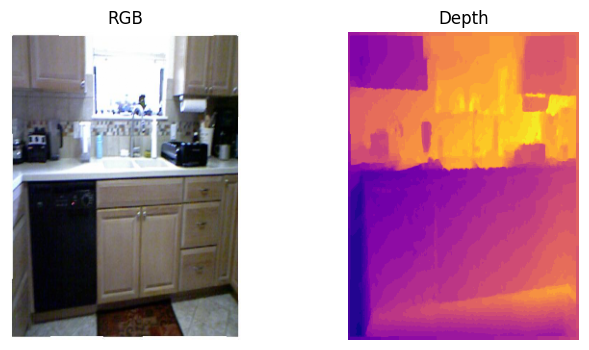

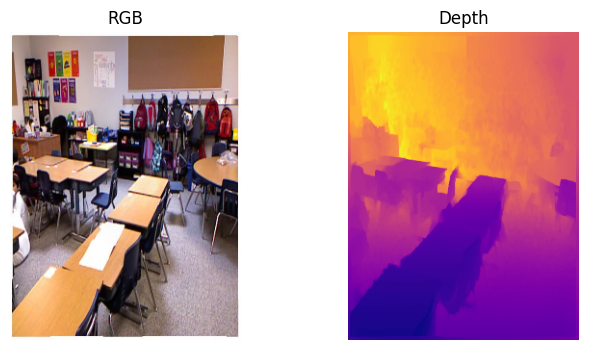

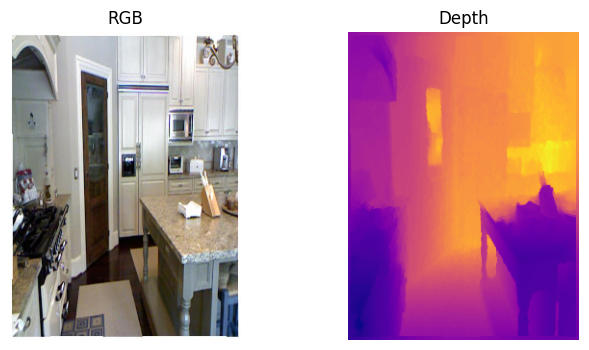

🔹 Validation Samples


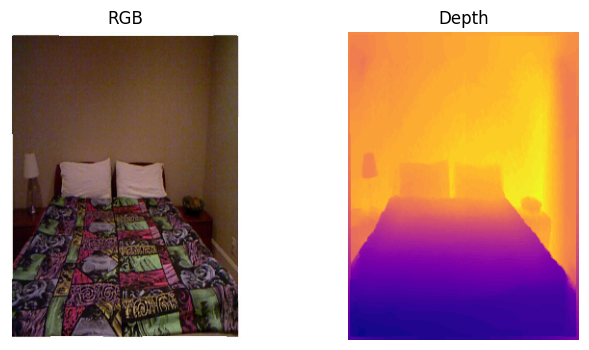

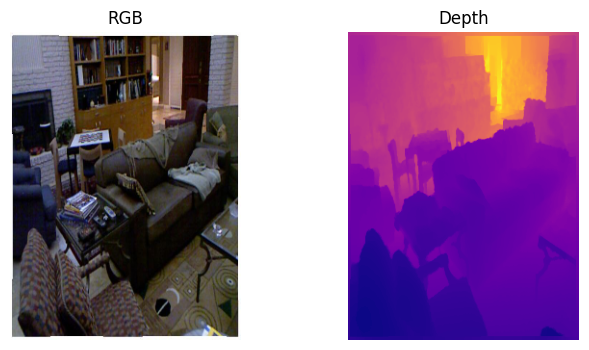

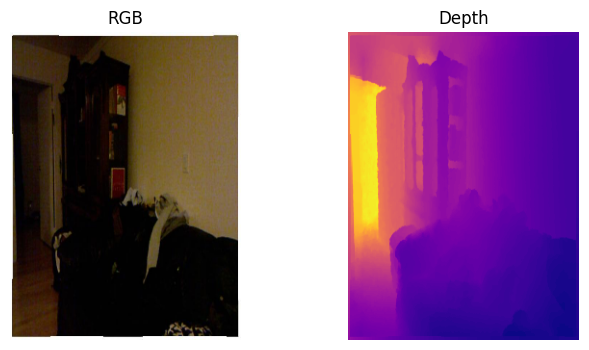

In [5]:
#Visualize a Few Samples

def viz(dl, num=3):
    imgs, deps = next(iter(dl))
    for i in range(min(num, imgs.size(0))):
        fig,axs=plt.subplots(1,2,figsize=(8,4))
        axs[0].imshow(imgs[i].permute(1,2,0).cpu())
        axs[0].set_title("RGB"); axs[0].axis("off")
        axs[1].imshow(deps[i].squeeze().cpu(), cmap="plasma")
        axs[1].set_title("Depth"); axs[1].axis("off")
        plt.show()

print("🔹 Training Samples"); viz(train_loader)
print("🔹 Validation Samples"); viz(val_loader)


# Define the Deep Learning model
Note: In this section, you need to define your own Deep Learning models for prediction

In [6]:
#Deep UNet (4 levels) with BatchNorm

class DoubleConv(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(in_c, out_c, 3, padding=1), nn.BatchNorm2d(out_c), nn.ReLU(inplace=True),
            nn.Conv2d(out_c, out_c,3, padding=1),  nn.BatchNorm2d(out_c), nn.ReLU(inplace=True),
        )
    def forward(self,x): return self.block(x)

class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.e1 = DoubleConv(3,64)
        self.e2 = DoubleConv(64,128)
        self.e3 = DoubleConv(128,256)
        self.e4 = DoubleConv(256,512)
        self.pool = nn.MaxPool2d(2)
        self.b  = DoubleConv(512,1024)

        self.u4 = nn.ConvTranspose2d(1024,512,2,2)
        self.d4 = DoubleConv(1024,512)
        self.u3 = nn.ConvTranspose2d(512,256,2,2)
        self.d3 = DoubleConv(512,256)
        self.u2 = nn.ConvTranspose2d(256,128,2,2)
        self.d2 = DoubleConv(256,128)
        self.u1 = nn.ConvTranspose2d(128, 64,2,2)
        self.d1 = DoubleConv(128, 64)

        self.out = nn.Conv2d(64,1,1)

    def forward(self,x):
        e1 = self.e1(x)
        e2 = self.e2(self.pool(e1))
        e3 = self.e3(self.pool(e2))
        e4 = self.e4(self.pool(e3))
        b  = self.b(self.pool(e4))

        d4 = self.u4(b);    d4 = self.d4(torch.cat([d4,e4],1))
        d3 = self.u3(d4);   d3 = self.d3(torch.cat([d3,e3],1))
        d2 = self.u2(d3);   d2 = self.d2(torch.cat([d2,e2],1))
        d1 = self.u1(d2);   d1 = self.d1(torch.cat([d1,e1],1))

        return self.out(d1)

model = UNet().to(device)



## Loss Functions
Note: Please define the training loss

In [7]:
#Scale‑Invariant Loss

def scale_invariant_loss(pred, target):
    pred   = torch.clamp(pred,   min=1e-3)
    target = torch.clamp(target, min=1e-3)
    d = torch.log(pred) - torch.log(target)
    return torch.mean(d**2) - 0.5*(torch.mean(d))**2


## Optimizer, Scheduler, Early Stopping

In [8]:
#Optimizer, Scheduler, Early Stopping

optimizer = AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=3, verbose=True
)

early_stop_patience = 7
no_improve = 0
best_val = float("inf")
save_path = "end.pth"


/home/shrayar/.conda/envs/nyuenv/lib/python3.9/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


## Training Loop
Note: This section contains the training loop. It iterates over the specified number of epochs and trains the model on the training set. During the validation phase, it evaluates the model on the validation set without performing backpropagation and optimization. The loss for each epoch is calculated and printed.

In [9]:
#Training Loop

num_epochs = 25
train_losses, val_losses = [], []

for epoch in range(1, num_epochs+1):
    model.train()
    tl = 0.0
    for imgs, deps in tqdm(train_loader, desc=f"Epoch {epoch}/{num_epochs}"):
        imgs, deps = imgs.to(device), deps.to(device)
        optimizer.zero_grad()
        out = model(imgs)
        loss = scale_invariant_loss(out, deps)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        optimizer.step()
        tl += loss.item()
    tl /= len(train_loader)
    train_losses.append(tl)

    model.eval()
    vl = 0.0
    with torch.no_grad():
        for imgs, deps in val_loader:
            imgs, deps = imgs.to(device), deps.to(device)
            vl += scale_invariant_loss(model(imgs), deps).item()
    vl /= len(val_loader)
    val_losses.append(vl)

    print(f"✅ Epoch {epoch}/{num_epochs} — Train: {tl:.4f} | Val: {vl:.4f}")

    scheduler.step(vl)
    if vl < best_val:
        best_val = vl
        no_improve = 0
        torch.save(model.state_dict(), save_path)
        print("💾 Best model saved.")
    else:
        no_improve += 1
        if no_improve >= early_stop_patience:
            print("⏸ Early stopping")
            break

torch.save(model.state_dict(), "final_end.pth")
print("📝 Final model saved.")


Epoch 1/25: 100%|███████████████████████████| 2813/2813 [05:52<00:00,  7.98it/s]


✅ Epoch 1/25 — Train: 3.8678 | Val: 1.6602
💾 Best model saved.


Epoch 2/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 2/25 — Train: 0.9778 | Val: 0.6024
💾 Best model saved.


Epoch 3/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 3/25 — Train: 0.3557 | Val: 0.2182
💾 Best model saved.


Epoch 4/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 4/25 — Train: 0.1119 | Val: 0.0489
💾 Best model saved.


Epoch 5/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 5/25 — Train: 0.0350 | Val: 0.0236
💾 Best model saved.


Epoch 6/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 6/25 — Train: 0.0207 | Val: 0.0196
💾 Best model saved.


Epoch 7/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 7/25 — Train: 0.0168 | Val: 0.0146
💾 Best model saved.


Epoch 8/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 8/25 — Train: 0.0134 | Val: 0.0170


Epoch 9/25: 100%|███████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 9/25 — Train: 0.0111 | Val: 0.0131
💾 Best model saved.


Epoch 10/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 10/25 — Train: 0.0097 | Val: 0.0098
💾 Best model saved.


Epoch 11/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 11/25 — Train: 0.0085 | Val: 0.0093
💾 Best model saved.


Epoch 12/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 12/25 — Train: 0.0079 | Val: 0.0078
💾 Best model saved.


Epoch 13/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 13/25 — Train: 0.0071 | Val: 0.0074
💾 Best model saved.


Epoch 14/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 14/25 — Train: 0.0065 | Val: 0.0072
💾 Best model saved.


Epoch 15/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 15/25 — Train: 0.0061 | Val: 0.0073


Epoch 16/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 16/25 — Train: 0.0058 | Val: 0.0069
💾 Best model saved.


Epoch 17/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 17/25 — Train: 0.0054 | Val: 0.0060
💾 Best model saved.


Epoch 18/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 18/25 — Train: 0.0050 | Val: 0.0059
💾 Best model saved.


Epoch 19/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 19/25 — Train: 0.0049 | Val: 0.0056
💾 Best model saved.


Epoch 20/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 20/25 — Train: 0.0046 | Val: 0.0058


Epoch 21/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 21/25 — Train: 0.0043 | Val: 0.0063


Epoch 22/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 22/25 — Train: 0.0042 | Val: 0.0056


Epoch 23/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 23/25 — Train: 0.0039 | Val: 0.0051
💾 Best model saved.


Epoch 24/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.00it/s]


✅ Epoch 24/25 — Train: 0.0038 | Val: 0.0061


Epoch 25/25: 100%|██████████████████████████| 2813/2813 [05:51<00:00,  8.01it/s]


✅ Epoch 25/25 — Train: 0.0036 | Val: 0.0049
💾 Best model saved.
📝 Final model saved.


## Visualize the Training  and Validation Curve
Note: In this section, you need to visualize the Training curve in the training loop

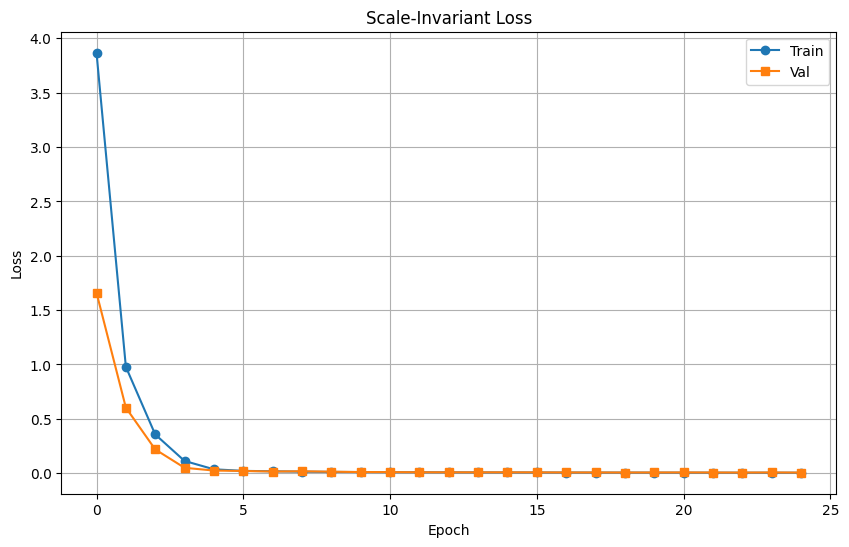

In [10]:
#Loss Convergence
plt.plot(train_losses, label="Train", marker="o")
plt.plot(val_losses,   label="Val",   marker="s")
plt.xlabel("Epoch"); plt.ylabel("Loss")
plt.title("Scale‑Invariant Loss"); plt.legend(); plt.grid(True)
plt.show()


## Visualize Validation Results


🔹 Validation Predictions:


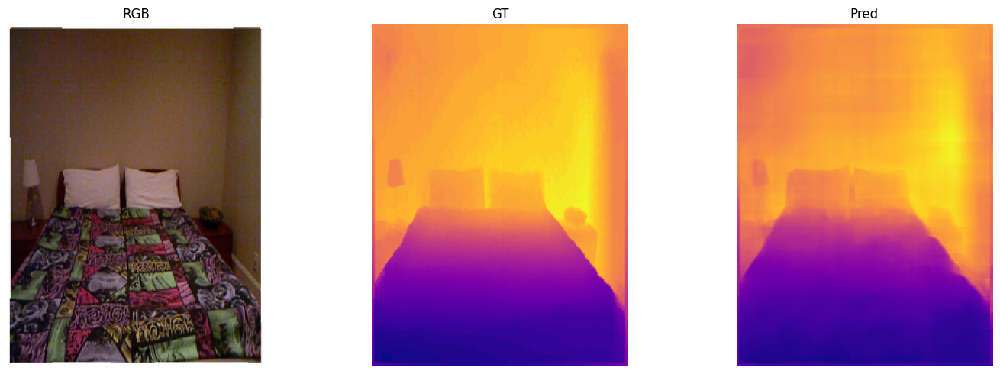

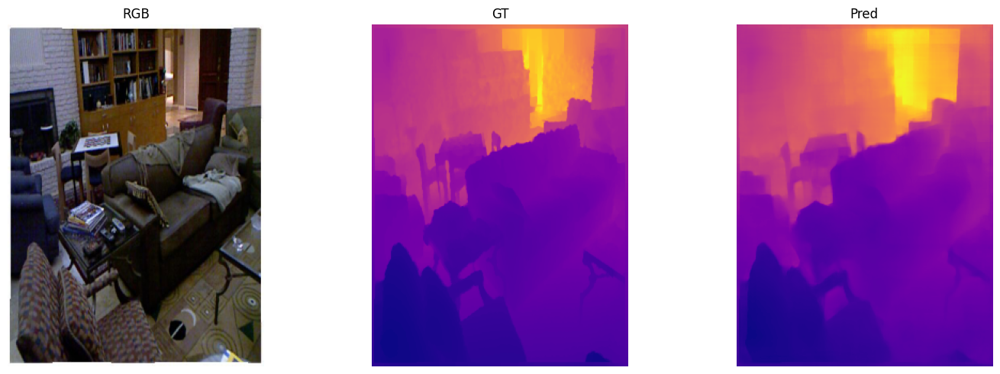

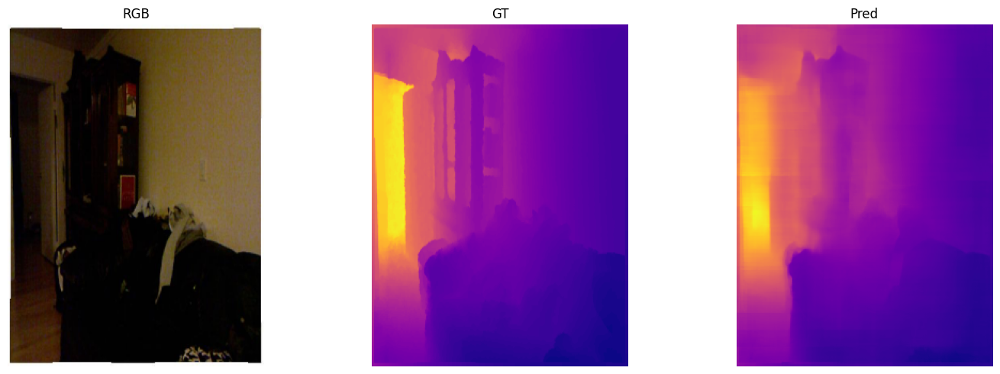

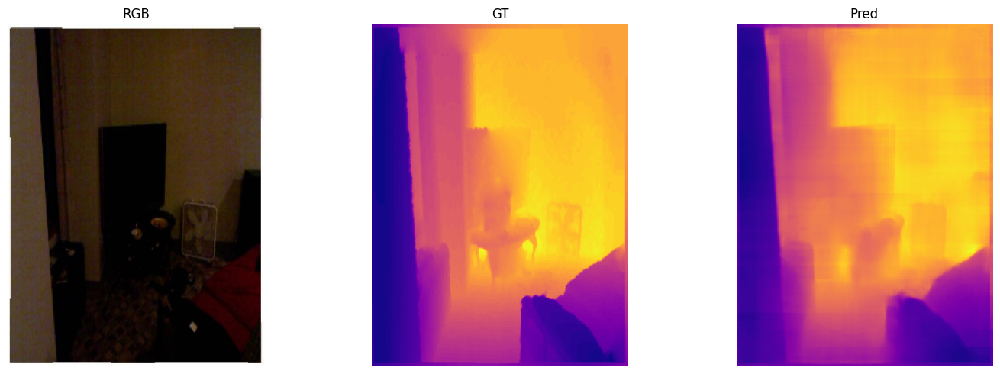

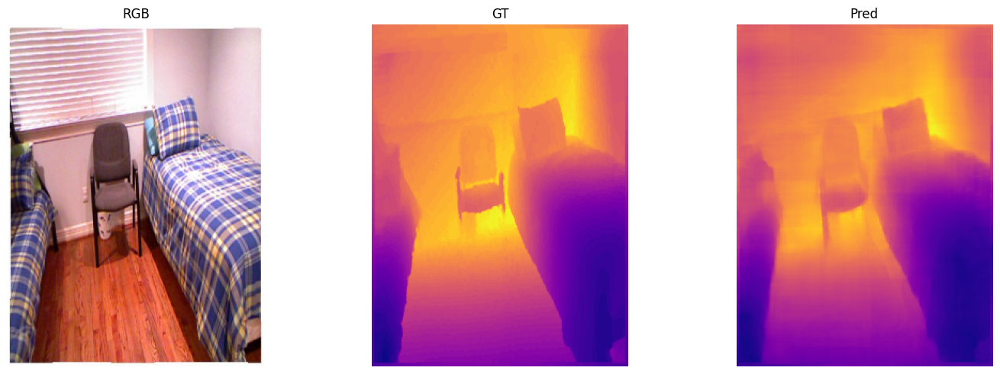

...

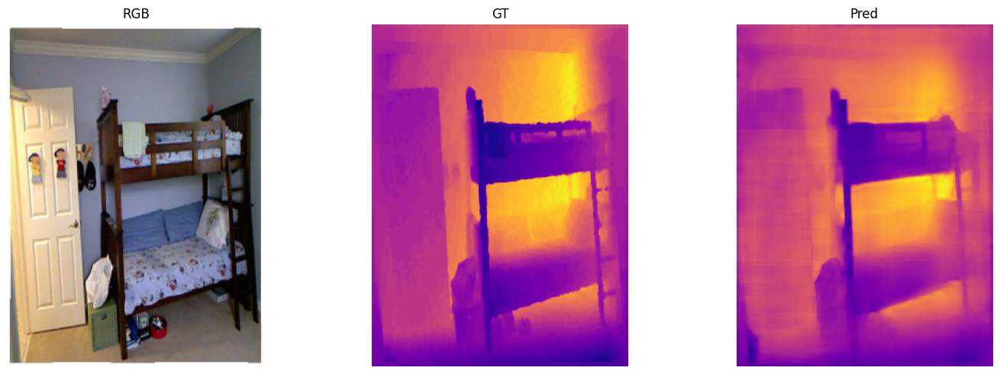

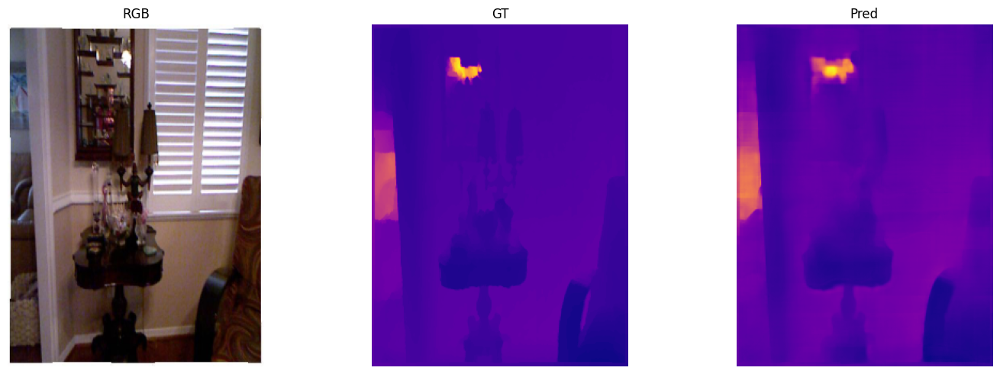

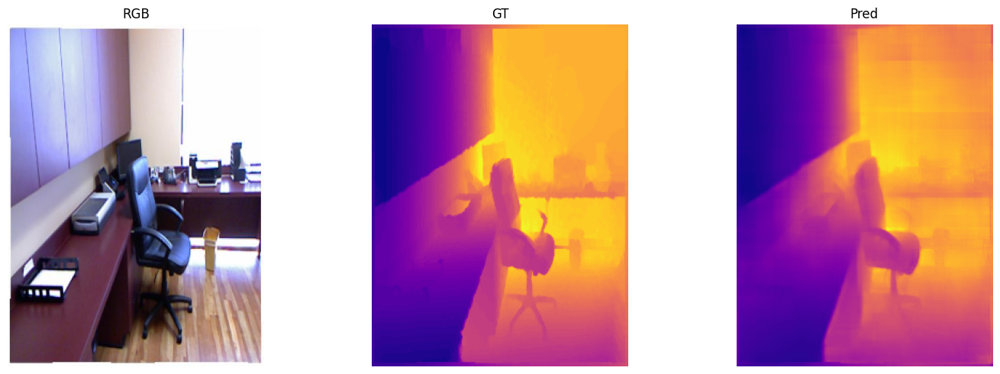

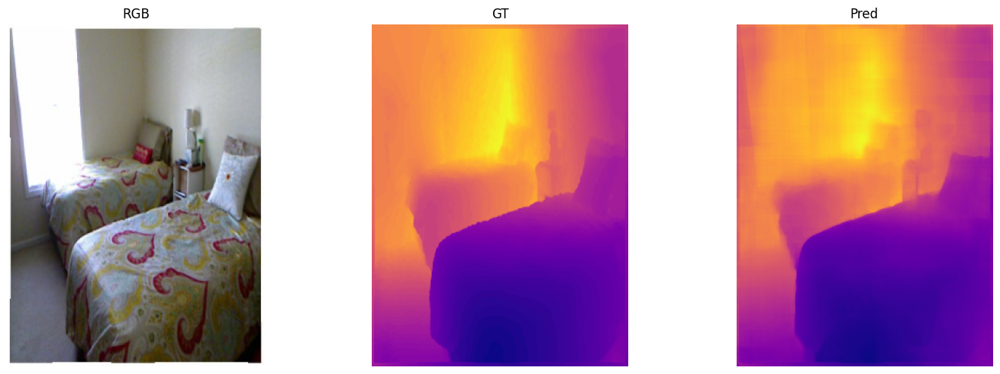

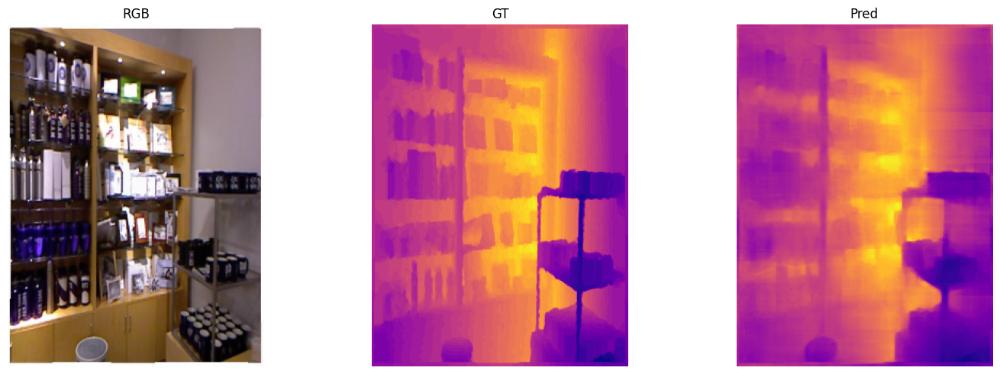

In [13]:
# Visualize N predictions (across multiple batches)
def visualize_predictions(dl, n=40):
    model.eval()
    shown = 0
    it = iter(dl)

    while shown < n:
        try:
            imgs, deps = next(it)
        except StopIteration:
            print(f"⚠️  Ran out of data after showing {shown} images.")
            break

        imgs, deps = imgs.to(device), deps.to(device)
        with torch.no_grad():
            preds = model(imgs)

        bs = imgs.size(0)
        for i in range(bs):
            if shown >= n:
                return

            fig, axs = plt.subplots(1, 3, figsize=(15, 5))
            # RGB
            axs[0].imshow(imgs[i].cpu().permute(1, 2, 0))
            axs[0].set_title("RGB")
            axs[0].axis("off")
            # Ground‐truth
            axs[1].imshow(deps[i].squeeze().cpu(), cmap="plasma")
            axs[1].set_title("GT")
            axs[1].axis("off")
            # Prediction
            axs[2].imshow(preds[i].squeeze().cpu(), cmap="plasma")
            axs[2].set_title("Pred")
            axs[2].axis("off")
            plt.tight_layout()
            plt.show()

            shown += 1

print("🔹 Validation Predictions:")
visualize_predictions(val_loader, n=40)